In [1]:
using IntervalArithmetic
using Plots
using LinearAlgebra


In [14]:
xs = 0:0.1:1
f(x) = sin(π*x)
A = [f(x) for x in xs]

11-element Vector{Float64}:
 0.0
 0.3090169943749474
 0.5877852522924731
 0.8090169943749475
 0.9510565162951535
 1.0
 0.9510565162951536
 0.8090169943749475
 0.5877852522924732
 0.3090169943749475
 1.2246467991473532e-16

In [15]:
#interp_cubic = CubicInterpolation(xs, A)
spl = Spline1D(xs, A, k=3)

Spline1D(knots=[0.0,0.2 … 0.8,1.0] (9 elements), k=3, extrapolation="nearest", residual=0.0)

In [17]:
spl(.5)

0.9999999999999999

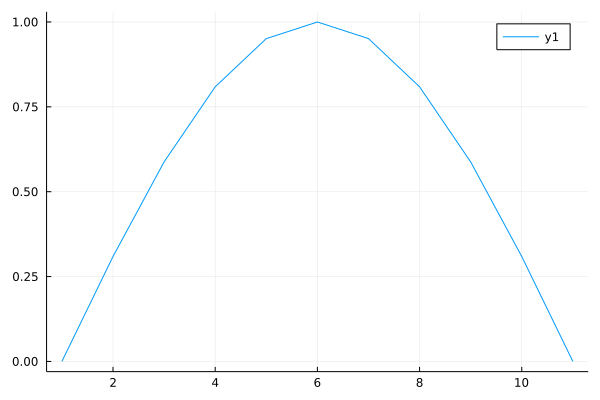

In [19]:
plot(spl(xs))

# Výpočet kubického splinu - intervalově

In [12]:
# vytvoření matice pro 
n=101
dv = [4..4 for i in 1:n-2]
ev = [1..1 for i in 1:n-3]
A = Array(SymTridiagonal(dv,ev))

99×99 Matrix{Interval{Float64}}:
 [4, 4]  [1, 1]  [0, 0]  [0, 0]  [0, 0]  …  [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [1, 1]  [4, 4]  [1, 1]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [1, 1]  [4, 4]  [1, 1]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [1, 1]  [4, 4]  [1, 1]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [1, 1]  [4, 4]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [1, 1]  …  [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]  …  [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0]  [0, 0]
 [0, 0]  [0, 0]  [0, 0]  [0, 0]  [0, 0]     [0, 0]  [0, 0]  [0, 0] 

In [13]:
# výpočet inverzní matice
@time begin
    A_inv = inv(A)
end

  0.015383 seconds (208 allocations: 471.266 KiB)


99×99 Matrix{Interval{Float64}}:
  [0.267949, 0.26795]          …   [2.21225e-57, 2.21226e-57]
 [-0.0717968, -0.0717967]         [-8.84904e-57, -8.84903e-57]
  [0.0192378, 0.0192379]           [3.31838e-56, 3.31839e-56]
 [-0.00515478, -0.00515477]       [-1.23887e-55, -1.23886e-55]
  [0.00138121, 0.00138122]         [4.62362e-55, 4.62363e-55]
 [-0.000370097, -0.000370096]  …  [-1.72557e-54, -1.72556e-54]
  [9.91669e-05, 9.9167e-05]        [6.43988e-54, 6.43989e-54]
 [-2.65718e-05, -2.65717e-05]     [-2.4034e-53, -2.40339e-53]
  [7.11987e-06, 7.11988e-06]       [8.9696e-53, 8.96961e-53]
 [-1.90777e-06, -1.90776e-06]     [-3.34751e-52, -3.3475e-52]
  [5.11183e-07, 5.11184e-07]   …   [1.2493e-51, 1.24931e-51]
 [-1.36972e-07, -1.36971e-07]     [-4.66247e-51, -4.66246e-51]
  [3.67013e-08, 3.67014e-08]       [1.74005e-50, 1.74006e-50]
   ⋮                           ⋱  
 [-4.66247e-51, -4.66246e-51]     [-1.36972e-07, -1.36971e-07]
  [1.2493e-51, 1.24931e-51]        [5.11183e-07, 5.11184e-07]

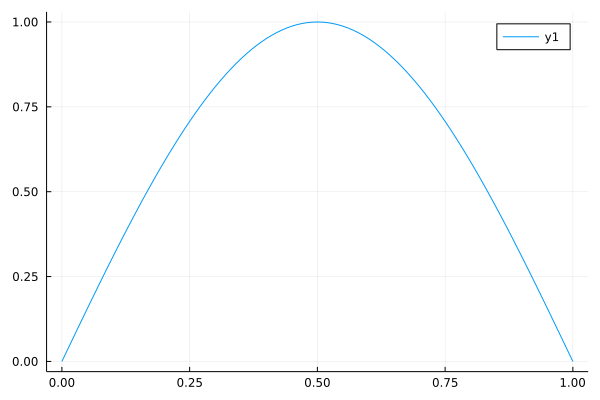

In [14]:
# napočtání bodů řešení
x_dis = range(0,1,length=n)
solu = sin.(π*x_dis) .+ 1e-6 #0.0001
#solu = [0.        , 0.12181192, 0.22507908, 0.29407999, 0.31830989,0.29407999, 0.22507908, 0.12181192, 0.]
plot(x_dis, solu)

In [15]:
# velikost kroku mezi body řešení solu 
# otázka jestli to nemá být taky interval 0..h
h = @interval x_dis[2]-x_dis[1]
# sestavení pravé strany
rhs = Interval[]
for i in 3:length(solu)
    append!(rhs, 6/h^2 * (@interval(solu[i]) - 2 * @interval(solu[i-1]) + @interval(solu[i-2])))
    #append!(rhs, 6/h^2 * (solu[i] - 2 * solu[i-1] + solu[i-2]))
    #append!(rhs, 6/h^2 * ((solu[i]..solu[i]) - 2 * (solu[i-1]..solu[i-1]) + (solu[i-2]..solu[i-2])))
end
rhs

99-element Vector{Interval}:
  [-1.85992, -1.85991]
  [-3.718, -3.71799]
  [-5.57242, -5.57241]
  [-7.42133, -7.42132]
  [-9.26292, -9.26291]
 [-11.0954, -11.0953]
 [-12.9169, -12.9168]
 [-14.7257, -14.7256]
 [-16.5199, -16.5198]
 [-18.2978, -18.2977]
 [-20.0577, -20.0576]
 [-21.7977, -21.7976]
 [-23.5163, -23.5162]
    ⋮
 [-21.7977, -21.7976]
 [-20.0577, -20.0576]
 [-18.2978, -18.2977]
 [-16.5199, -16.5198]
 [-14.7257, -14.7256]
 [-12.9169, -12.9168]
 [-11.0954, -11.0953]
  [-9.26292, -9.26291]
  [-7.42133, -7.42132]
  [-5.57242, -5.57241]
  [-3.718, -3.71799]
  [-1.85992, -1.85991]

In [16]:
# vypočte vektor druhých derivací potřebný na výpočet koeficientů
d2v = Interval[]
append!(d2v, @interval(-1))
append!(d2v, A_inv*rhs)

#    for i in range(A_inv.shape[0]):
#        di = i_('0')
#        for j in range(A_inv.shape[1]):
#            di = di + i_(str(A_inv.row(i).col(j)[0])) * rsv[j] 
#            # [0] je tam protože row() a col() vrací objekt Matrix
#        d2v.append(di)
#for i in 1:


append!(d2v, @interval(-1))
d2v

101-element Vector{Interval}:
 [-1, -1]
      [-0.310038, -0.310037]
      [-0.619769, -0.619768]
      [-0.928889, -0.928888]
      [-1.2371, -1.23709]
      [-1.54408, -1.54407]
      [-1.84954, -1.84953]
      [-2.15317, -2.15316]
      [-2.45468, -2.45467]
      [-2.75376, -2.75375]
      [-3.05013, -3.05012]
      [-3.34349, -3.34348]
      [-3.63355, -3.63354]
        ⋮
      [-3.34349, -3.34348]
      [-3.05013, -3.05012]
      [-2.75376, -2.75375]
      [-2.45468, -2.45467]
      [-2.15317, -2.15316]
      [-1.84954, -1.84953]
      [-1.54408, -1.54407]
      [-1.2371, -1.23709]
      [-0.928889, -0.928888]
      [-0.619769, -0.619768]
      [-0.310038, -0.310037]
 [-1, -1]

In [17]:
# výpočet koeficientů jednotlivých oblouků splinu
csc = [] #@interval zeros(4, length(solu)-1)
for i in 1:length(solu)-1
    a=b=c=d=0
    a = (d2v[i+1]-d2v[i])/(6*h)
    b = d2v[i]/2 
    c = (@interval solu[i+1] - @interval solu[i])/h - h*(2*d2v[i]+d2v[i+1])/6
    d = @interval solu[i]
    append!(csc, [[a,b,c,d]])
    #csc[1, i] = a
end
csc

100-element Vector{Any}:
 Interval{Float64}[[11.4993, 11.4994], [-0.5, -0.5], [3.14492, 3.14493], [9.99999e-07, 1.00001e-06]]
 Interval{Float64}[[-5.16219, -5.16218], [-0.155019, -0.155018], [3.14004, 3.14005], [0.0314117, 0.0314118]]
 Interval{Float64}[[-5.152, -5.15199], [-0.309885, -0.309884], [3.13539, 3.1354], [0.0627915, 0.0627916]]
 Interval{Float64}[[-5.13672, -5.13671], [-0.464445, -0.464444], [3.12765, 3.12766], [0.0941093, 0.0941094]]
 Interval{Float64}[[-5.11637, -5.11636], [-0.618546, -0.618545], [3.11682, 3.11683], [0.125334, 0.125335]]
 Interval{Float64}[[-5.09098, -5.09097], [-0.772037, -0.772036], [3.10291, 3.10292], [0.156435, 0.156436]]
 Interval{Float64}[[-5.06056, -5.06055], [-0.924766, -0.924765], [3.08594, 3.08595], [0.187382, 0.187383]]
 Interval{Float64}[[-5.02514, -5.02513], [-1.07659, -1.07658], [3.06593, 3.06594], [0.218144, 0.218145]]
 Interval{Float64}[[-4.98477, -4.98476], [-1.22734, -1.22733], [3.04289, 3.0429], [0.24869, 0.248691]]
 Interval{Float64}[[-

In [19]:
xn = 101
#plot(0..1,0..1)

#p = plot(x_dis, solu)
f(x)= sin(π*x)
p = plot(f,0,1)
for i in 1:length(solu)-1
    x_dom = x_dis[i]..x_dis[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    f(x) = csc[i][1]*(x- @interval(x_dis[i]))^3 + csc[i][2]*(x-@interval(x_dis[i]))^2 + csc[i][3]*(x- @interval(x_dis[i])) + csc[i][4]
    res = f.(x_int)
    #println(res)
    boxes = IntervalBox.(x_int, res)
    
    plot!(boxes, legend=false)
end
p

In [20]:
# první derivace
csc_d1 = []
for i in 1:length(csc)
    append!(csc_d1, [[3*csc[i][1],2*csc[i][2],csc[i][3]]])
end
csc_d1

100-element Vector{Any}:
 Interval{Float64}[[34.4981, 34.4982], [-1, -1], [3.14492, 3.14493]]
 Interval{Float64}[[-15.4866, -15.4865], [-0.310038, -0.310037], [3.14004, 3.14005]]
 Interval{Float64}[[-15.456, -15.4559], [-0.619769, -0.619768], [3.13539, 3.1354]]
 Interval{Float64}[[-15.4102, -15.4101], [-0.928889, -0.928888], [3.12765, 3.12766]]
 Interval{Float64}[[-15.3492, -15.3491], [-1.2371, -1.23709], [3.11682, 3.11683]]
 Interval{Float64}[[-15.273, -15.2729], [-1.54408, -1.54407], [3.10291, 3.10292]]
 Interval{Float64}[[-15.1817, -15.1816], [-1.84954, -1.84953], [3.08594, 3.08595]]
 Interval{Float64}[[-15.0755, -15.0754], [-2.15317, -2.15316], [3.06593, 3.06594]]
 Interval{Float64}[[-14.9543, -14.9542], [-2.45468, -2.45467], [3.04289, 3.0429]]
 Interval{Float64}[[-14.8185, -14.8184], [-2.75376, -2.75375], [3.01685, 3.01686]]
 Interval{Float64}[[-14.6679, -14.6678], [-3.05013, -3.05012], [2.98783, 2.98784]]
 Interval{Float64}[[-14.503, -14.5029], [-3.34349, -3.34348], [2.95586, 2.9

In [21]:
#první derivace
#xn = 3
f(x)= π*cos(π*x)
p = plot(f,0,1)
for i in 1:length(solu)-1
    x_dom = x_dis[i]..x_dis[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    f(x) = csc_d1[i][1]*(x- @interval(x_dis[i]))^2 + csc_d1[i][2]*(x-@interval(x_dis[i])) + csc_d1[i][3]
    boxes = IntervalBox.(x_int, f.(x_int))
    plot!(boxes, legend=false)
end
p

In [22]:
#druhá derivace
csc_d2 = []
for i in 1:length(csc)
    append!(csc_d2, [[6*csc[i][1],2*csc[i][2]]])
end
csc_d2

100-element Vector{Any}:
 Interval{Float64}[[68.9962, 68.9963], [-1, -1]]
 Interval{Float64}[[-30.9732, -30.9731], [-0.310038, -0.310037]]
 Interval{Float64}[[-30.912, -30.9119], [-0.619769, -0.619768]]
 Interval{Float64}[[-30.8203, -30.8202], [-0.928889, -0.928888]]
 Interval{Float64}[[-30.6983, -30.6982], [-1.2371, -1.23709]]
 Interval{Float64}[[-30.5459, -30.5458], [-1.54408, -1.54407]]
 Interval{Float64}[[-30.3634, -30.3633], [-1.84954, -1.84953]]
 Interval{Float64}[[-30.1509, -30.1508], [-2.15317, -2.15316]]
 Interval{Float64}[[-29.9086, -29.9085], [-2.45468, -2.45467]]
 Interval{Float64}[[-29.6369, -29.6368], [-2.75376, -2.75375]]
 Interval{Float64}[[-29.3358, -29.3357], [-3.05013, -3.05012]]
 Interval{Float64}[[-29.0059, -29.0058], [-3.34349, -3.34348]]
 Interval{Float64}[[-28.6473, -28.6472], [-3.63355, -3.63354]]
 ⋮
 Interval{Float64}[[29.0058, 29.0059], [-3.63355, -3.63354]]
 Interval{Float64}[[29.3357, 29.3358], [-3.34349, -3.34348]]
 Interval{Float64}[[29.6368, 29.6369], [-

In [23]:
#druhá derivace
xn = 101
f(x)= -π^2*sin(π*x)
p = plot(f,0,1)
for i in 1:length(solu)-1
    x_dom = x_dis[i]..x_dis[i+1] # domain # range(0,1,length=n)
    x_int = mince(x_dom,xn)
    f(x) = csc_d2[i][1]*(x- @interval(x_dis[i])) + csc_d2[i][2]
    boxes = IntervalBox.(x_int, f.(x_int))
    plot!(boxes, legend=false)
end
p

In [24]:
#druhá derivace
#xn = 3
@time begin
    xn = 101
    f(x)= π^2 # 0#-π^2*sin(π*x)
    p = plot(f,0,1)
    λ_low = []
    for i in 1:length(solu)-1
        x_dom = x_dis[i]..x_dis[i+1] # domain # range(0,1,length=n)
        x_int = mince(x_dom,xn)
        f(x) = -(csc_d2[i][1]*(x- @interval(x_dis[i])) + csc_d2[i][2]) / (csc[i][1]*(x- @interval(x_dis[i]))^3 + csc[i][2]*(x-@interval(x_dis[i]))^2 + csc[i][3]*(x- @interval(x_dis[i])) + csc[i][4]) 
        #println(
        #f_2der(x) = csc_d2[i][1]*(x- @interval(x_dis[i])) + csc_d2[i][2]
        #v = f/f_2der
        res = f.(x_int)
        boxes = IntervalBox.(x_int, res)
        #println(res)
        append!(λ_low, minimum(inf.(res)))
        plot!(boxes, legend=false, ylim=[8,9.95])
    end
    λ1 = minimum(λ_low)
    println("Horní odhad λ₁: $λ1")
    println("Chyba proti přesné hodnotě: $(λ1-π^2)")

    p
end

Horní odhad λ₁: 9.77332450859571
Chyba proti přesné hodnotě: -0.09627989249364788
  4.831445 seconds (9.51 M allocations: 539.696 MiB, 1.85% gc time, 0.99% compilation time)


In [15]:
    println("Chyba proti přesné hodnotě: $(λ1-π^2)")

Chyba proti přesné hodnotě: -0.009040863998281523


# ... a teď s p-laplacianem

In [25]:
P = 5//2


5//2

In [26]:
### potřebuju dopsat ještě derivování (divergence operator), jinak to není celej plaplacian



@time begin
    xn = 11
    f(x)= π^2 # 0#-π^2*sin(π*x)
    p = plot(f,0,1)
    λ_low = []
    for i in 1:length(solu)-1
        x_dom = x_dis[i]..x_dis[i+1] # domain # range(0,1,length=n)
        x_int = mince(x_dom,xn)
        v(x) = -((abs(csc_d1[i][1]*(x- @interval(x_dis[i]))^2 + csc_d1[i][2]*(x- @interval(x_dis[i])) + csc_d1[i][3]))^(P-2) *
            (csc_d1[i][1]*(x- @interval(x_dis[i]))^2 + csc_d1[i][2]*(x- @interval(x_dis[i])) + csc_d1[i][3]))  #/
            #(csc[i][1]*(x- @interval(x_dis[i]))^3 + csc[i][2]*(x-@interval(x_dis[i]))^2 + csc[i][3]*(x- @interval(x_dis[i])) + csc[i][4])^(P-1) 
        
        
        # tenhle řádek fakt nevim, je třeba proštudovat syntaxi
        v_grad = x_int -> ForwardDiff.derivative.(f,x_int)
        # tím získám -p-laplace a bude stačit vydělit následujícím řádkem
        
        #(csc[i][1]*(x- @interval(x_dis[i]))^3 + csc[i][2]*(x-@interval(x_dis[i]))^2 + csc[i][3]*(x- @interval(x_dis[i])) + csc[i][4])^(P-1) 
        
        
        #println(
        #f_2der(x) = csc_d2[i][1]*(x- @interval(x_dis[i])) + csc_d2[i][2]
        #v = f/f_2der
        res = f.(x_int)
        boxes = IntervalBox.(x_int, res)
        #println(res)
        append!(λ_low, minimum(inf.(res)))
        plot!(boxes, legend=false)#, ylim=[8,9.95])
    end
    λ1 = minimum(λ_low)
    println("Horní odhad λ₁: $λ1")
    println("Chyba proti přesné hodnotě: $(λ1-π^2)")

    p
end

LoadError: MethodError: no method matching inf(::Float64)
[0mClosest candidates are:
[0m  inf([91m::Interval[39m) at /Users/honzapulpan/.julia/packages/IntervalArithmetic/UR6Qe/src/intervals/arithmetic.jl:305
[0m  inf([91m::DecoratedInterval{T}[39m) where T at /Users/honzapulpan/.julia/packages/IntervalArithmetic/UR6Qe/src/decorations/functions.jl:54

In [79]:
i = 1
f(x) = -((abs(csc_d1[i][1]*(x- @interval(x_dis[i]))^2 + csc_d1[i][2]*(x- @interval(x_dis[i])) + csc_d1[i][3]))^(P-2) *
            (csc_d1[i][1]*(x- @interval(x_dis[i]))^2 + csc_d1[i][2]*(x- @interval(x_dis[i])) + csc_d1[i][3]))  /
            (csc[i][1]*(x- @interval(x_dis[i]))^3 + csc[i][2]*(x-@interval(x_dis[i]))^2 + csc[i][3]*(x- @interval(x_dis[i])) + csc[i][4])^(P-1) 

f (generic function with 1 method)

In [84]:
using ForwardDiff

In [115]:
f(x) = sin(π*x)+0.1

f (generic function with 1 method)

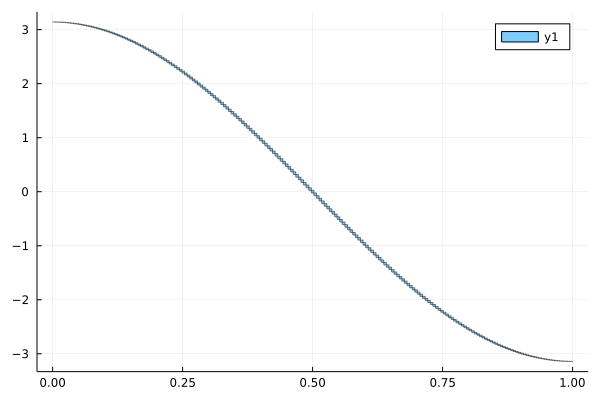

In [116]:
x_dom = 0..1 # domain # range(0,1,length=n)
x = mince(x_dom,201)

g = x -> ForwardDiff.derivative.(f,x)
d1 = g(x)
boxes = IntervalBox.(x,d1)
plot(boxes)


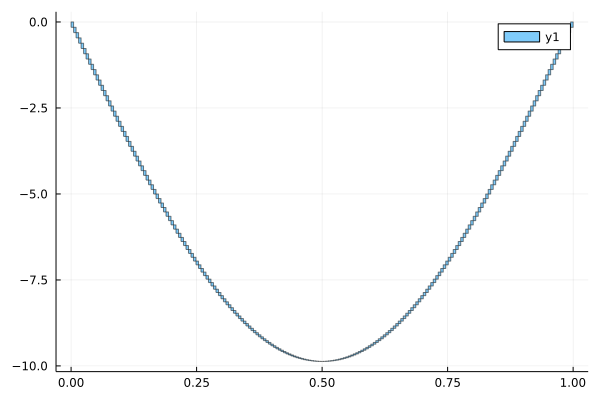

In [117]:
h = x-> ForwardDiff.derivative.(g,x)
d2=h(x)
boxes = IntervalBox.(x,d2)
plot(boxes)

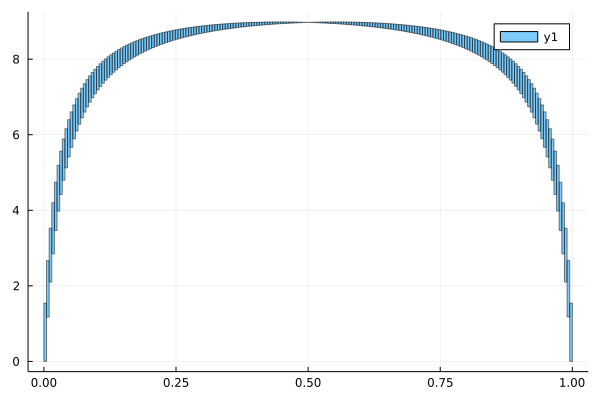

In [118]:
c(x) = -h(x)/f(x)
dd = c.(x)
boxes = IntervalBox.(x,dd)
plot(boxes)

In [119]:
dd

201-element Vector{Interval{Float64}}:
 [-0, 1.54254]
     [1.17522, 2.66776]
     [2.10025, 3.52454]
     [2.84721, 4.19847]
     [3.4629, 4.74227]
     [3.97908, 5.19014]
     [4.418, 5.56528]
     [4.79575, 5.88396]
     [5.12424, 6.15794]
     [5.41247, 6.39591]
     [5.66738, 6.60447]
     [5.89441, 6.78867]
     [6.09785, 6.9525]
      ⋮
     [5.89441, 6.78867]
     [5.66738, 6.60447]
     [5.41247, 6.39591]
     [5.12424, 6.15794]
     [4.79575, 5.88396]
     [4.418, 5.56528]
     [3.97908, 5.19014]
     [3.4629, 4.74227]
     [2.84721, 4.19847]
     [2.10025, 3.52454]
     [1.17522, 2.66776]
    [-3.17431e-14, 1.54254]

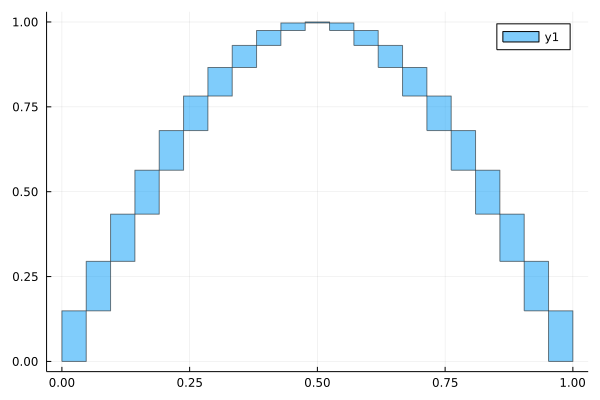

In [85]:

x_dom = 0..1 # domain # range(0,1,length=n)
x = mince(x_dom,21)
u = sin.(π*x)
boxes = IntervalBox.(x, u)
plot(boxes)


In [67]:
plapl = u

21-element Vector{Interval{Float64}}:
 [0, 0.149043]
    [0.149042, 0.294756]
    [0.294755, 0.433884]
    [0.433883, 0.563321]
    [0.56332, 0.680173]
    [0.680172, 0.781832]
    [0.781831, 0.866026]
    [0.866025, 0.930874]
    [0.930873, 0.974928]
    [0.974927, 0.997204]
    [0.997203, 1]
    [0.974927, 0.997204]
    [0.930873, 0.974928]
    [0.866025, 0.930874]
    [0.781831, 0.866026]
    [0.680172, 0.781832]
    [0.56332, 0.680173]
    [0.433883, 0.563321]
    [0.294755, 0.433884]
    [0.149042, 0.294756]
   [-3.21625e-16, 0.149043]

# Výpočet jen přes intervalovou aritmetiku - nefunguje

In [48]:
n = 30 # počet bodů dělení
x_dom = 0..1 # domain # range(0,1,length=n)
x = mince(x_dom,n)
#x_dis = range(0,1,length=n)

30-element Vector{Interval{Float64}}:
 [0, 0.0333334]
    [0.0333333, 0.0666667]
    [0.0666666, 0.100001]
    [0.1, 0.133334]
    [0.133333, 0.166667]
    [0.166666, 0.200001]
    [0.2, 0.233334]
    [0.233333, 0.266667]
    [0.266666, 0.3]
    [0.299999, 0.333334]
    [0.333333, 0.366667]
    [0.366666, 0.400001]
    [0.4, 0.433334]
     ⋮
    [0.599999, 0.633334]
    [0.633333, 0.666667]
    [0.666666, 0.7]
    [0.699999, 0.733334]
    [0.733333, 0.766667]
    [0.766666, 0.800001]
    [0.8, 0.833334]
    [0.833333, 0.866667]
    [0.866666, 0.900001]
    [0.9, 0.933334]
    [0.933333, 0.966667]
    [0.966666, 1]

In [49]:
#Metoda jak naplnit pole, ale není přesná. Otázka je, jestli na sebe intervaly správně navazují. Lepší je to co jsme napsal nahoře
#x_int = Interval[]# zeros(n-1)
#for i in 1:length(x)-1
#    append!(x_int, x[i]..x[i+1])
#end

Interval{Float64}[[0, 0.834355], [0.834354, 1], [0.179729, 0.91984], [-0.721696, 0.17973], [-1, -0.721695], [-0.975368, -0.353605], [-0.353606, 0.585534], [0.585533, 1], [0.515965, 0.999131], [-0.430302, 0.515966]]
Interval{Float64}[[0, 0.31416], [0.314159, 0.628319], [0.628318, 0.942478], [0.942477, 1.25664], [1.25663, 1.5708], [1.57079, 1.88496], [1.88495, 2.19912], [2.19911, 2.51328], [2.51327, 2.82744], [2.82743, 3.1416]]


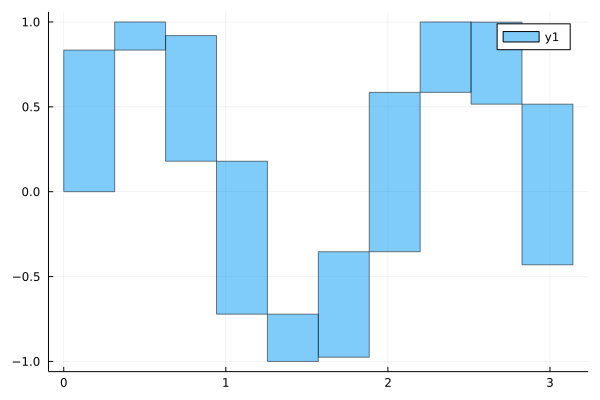

In [53]:
# tahle varianta je asi horší, není přesná a nezahrnuje celej interval
#u = sin.(π*x)
#u_tmp = interval.(u)
#u_int2 = Interval[]
#for i in 1:length(u_tmp)-1
#    append!(u_int2, u_tmp[i] ∪ u_tmp[i+1])
#end

#jako lepší vypadá varianta která počítá sinus z cele'ého intervalu
u = sin.(π*x)
println(u)
println(x)
boxes = IntervalBox.(x, u)
plot(boxes)

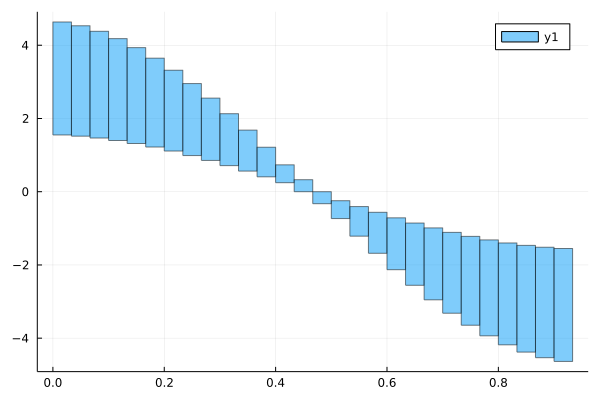

In [51]:
### výpočet derivace pomocí centrální diference

u_der = Interval[]
for i in 2:length(u)-1
    append!(u_der, (u[i+1]-u[i-1])/(2*diam(x[i])))
end

boxes_der = IntervalBox.(x[1:n-2], u_der)
plot(boxes_der)

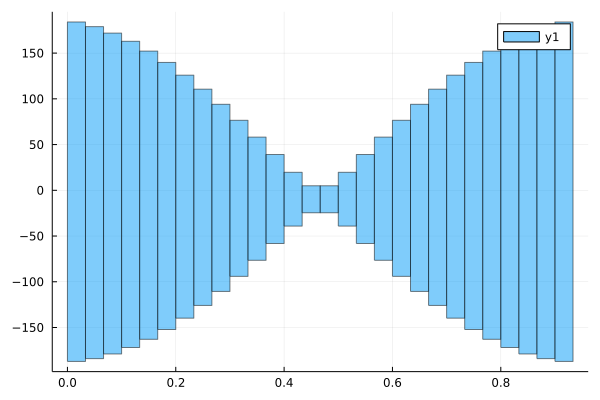

In [55]:
### výpočet derivace pomocí centrální diference

u_2der = Interval[]
for i in 2:length(u)-1
    append!(u_2der, (u[i-1]-2*u[i]+u[i+1])/(diam(x[i])^2))
end

boxes_der = IntervalBox.(x[1:n-2], u_2der)
plot(boxes_der)

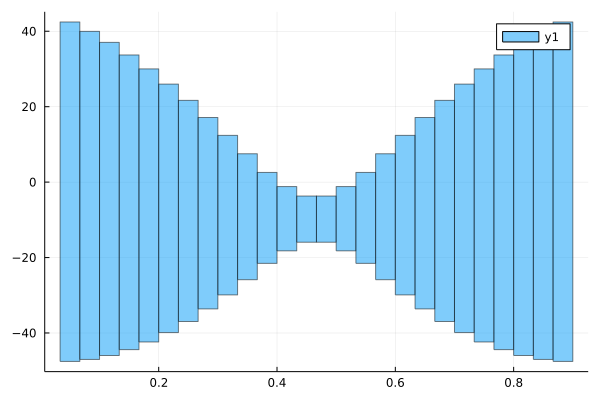

In [57]:
### výpočet 2. derivace pomocí centrální diference

u_2der = Interval[]
for i in 2:length(u_der)-1
    append!(u_2der, (u_der[i+1]-u_der[i-1])/(2*diam(x[i])))
end

boxes_2der = IntervalBox.(x[2:n-3], u_2der)
plot(boxes_2der)

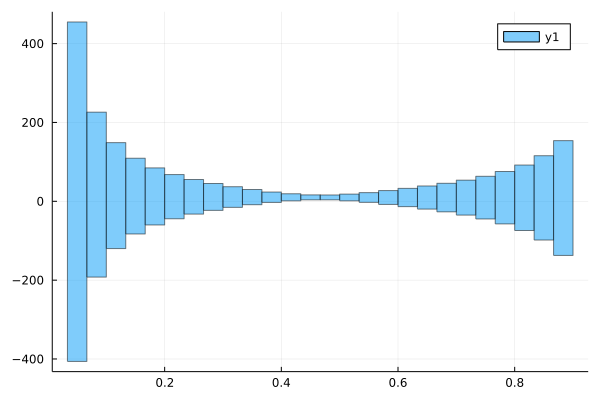

In [58]:
picone = -u_2der ./ u[2:n-3]
boxes_picone = IntervalBox.(x[2:n-3], picone)
plot(boxes_picone)

In [13]:
picone[50]

[1.22873, 18.4888]

# Zkouška ForwardDiff

In [43]:
using ForwardDiff
using IntervalArithmetic

In [77]:
#f(x) = sin(@interval(x)) + @interval(0.001)
f(x) = sin(x)

f (generic function with 1 method)

In [78]:
g = x -> ForwardDiff.derivative(f, x);

In [79]:
h = x -> ForwardDiff.derivative(g, x);

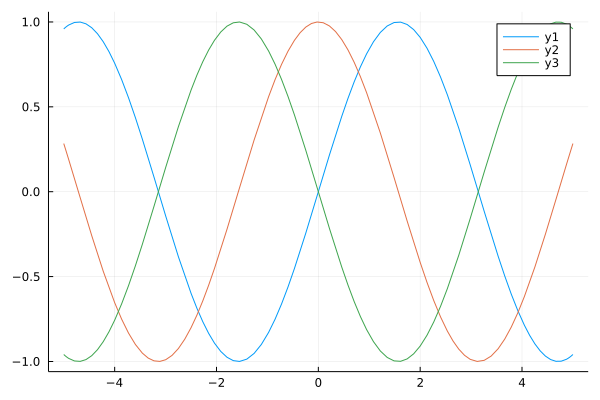

In [80]:


plot(f)
plot!(g)
plot!(h)

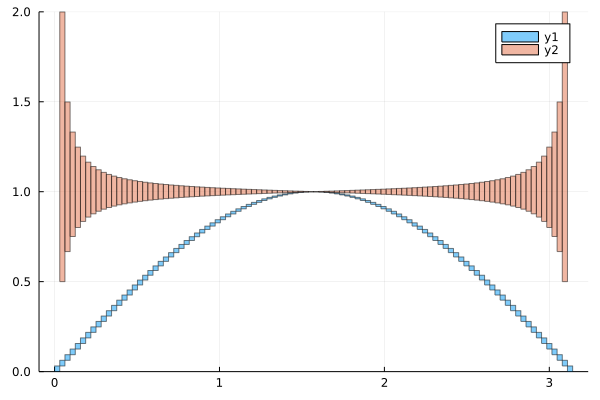

In [81]:
n = 100 # počet bodů dělení
x_dom = 0..π # domain # range(0,1,length=n)
x = mince(x_dom,n)

u = f.(x)
v = g.(x)
p = -h.(x) ./ f.(x)
boxes = IntervalBox.(x, u)
boxes_der = IntervalBox.(x, p)
plot(boxes)
plot!(boxes_der, ylim=(0,2))

In [68]:
p

100-element Vector{Interval{Float64}}:
 [-0, 31.4108]
      [0.492404, 1.93734]
      [0.6602, 1.47528]
      [0.744921, 1.3178]
      [0.796097, 1.23827]
      [0.830413, 1.19022]
      [0.855063, 1.15799]
      [0.873656, 1.13483]
      [0.888206, 1.11736]
      [0.899921, 1.10367]
      [0.909574, 1.09265]
      [0.917679, 1.08356]
      [0.924592, 1.07592]
       ⋮
      [0.917679, 1.08356]
      [0.909574, 1.09265]
      [0.899921, 1.10367]
      [0.888206, 1.11736]
      [0.873656, 1.13483]
      [0.855063, 1.15799]
      [0.830413, 1.19022]
      [0.796097, 1.23827]
      [0.744921, 1.3178]
      [0.6602, 1.47528]
      [0.492404, 1.93734]
     [-3.21625e-13, 31.4108]

# KONEC

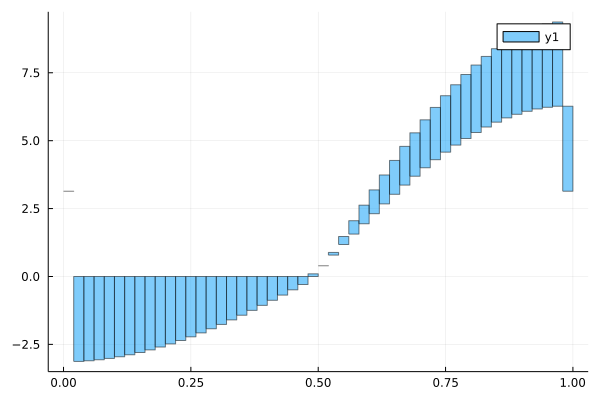

In [68]:
#=

Tohle nefunguje vůbec hezky, někde tam mám nejspíš chybu.

Lepší je počítat derivaci/diferenci přímo intervalově

viz nahoře

=#

u_der2 = Interval[(inf(u[2])-inf(u[1]))/diam(x[1])..(sup(u[1])-inf(u[1]))/diam(x[1])]
for i in 2:length(x)-1
    #println(i)
    u1 = (sup(u[i-1])-inf(u[i+1]))/diam(x[i])
    u2 = (sup(u[i])-inf(u[i+1]))/diam(x[i])
    if u2 > u1
        append!(u_der2, u1..u2)
    else
        append!(u_der2, u2..u1)
    end
end

i = length(x)
u1 = (sup(u[i-1])-inf(u[i]))/diam(x[i])
u2 = (sup(u[i])-inf(u[i]))/diam(x[i])
if u2 > u1
    append!(u_der2, u1..u2)
else
    append!(u_der2, u2..u1)
end

boxes_der2 = IntervalBox.(x, u_der2)
plot(boxes_der2)

In [69]:
# druhá derivace

### výpočet derivace

u_2der = Interval[]
for i in 1:length(u_der)-1
    append!(u_2der, (u_der[i+1]-u_der[i])/diam(x[i]))
end
u_2der

47-element Vector{Interval}:
 [-156.667, 154.196]
 [-155.739, 152.045]
 [-154.196, 149.294]
 [-152.045, 145.953]
 [-149.294, 142.037]
 [-145.953, 137.56]
 [-142.037, 132.54]
 [-137.56, 126.997]
 [-132.54, 120.953]
 [-126.997, 114.431]
 [-120.953, 107.458]
 [-114.431, 100.061]
 [-107.458, 92.2684]
     ⋮
 [-114.431, 100.061]
 [-120.953, 107.458]
 [-126.997, 114.431]
 [-132.54, 120.953]
 [-137.56, 126.997]
 [-142.037, 132.54]
 [-145.953, 137.56]
 [-149.294, 142.037]
 [-152.045, 145.953]
 [-154.196, 149.294]
 [-155.739, 152.045]
 [-156.667, 154.196]

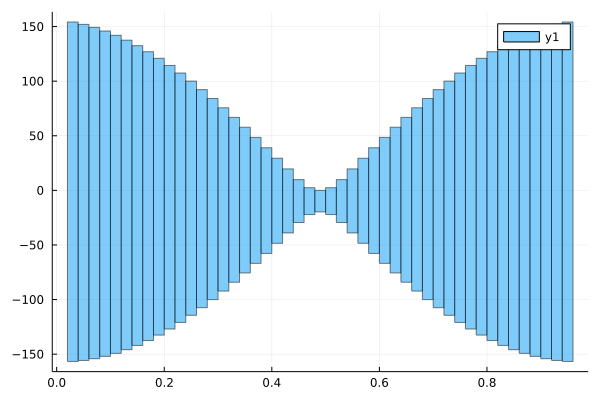

In [72]:
boxes_2der = IntervalBox.(x[2:n-2], u_2der)
plot(boxes_2der)

In [73]:
# 2. derivace jinak
u_2der2 = Interval[]
for i in 2:length(u)-1
    append!(u_2der2, (u[i+1]-2*u[i]+u[i-1])/(diam(x[i])^2))
end
u_2der2

48-element Vector{Interval}:
 [-313.334, 311.477]
 [-311.477, 308.392]
 [-308.392, 304.09]
 [-304.09, 298.587]
 [-298.587, 291.906]
 [-291.906, 284.073]
 [-284.073, 275.119]
 [-275.119, 265.079]
 [-265.079, 253.993]
 [-253.993, 241.905]
 [-241.905, 228.862]
 [-228.862, 214.916]
 [-214.916, 200.121]
     ⋮
 [-228.862, 214.916]
 [-241.905, 228.862]
 [-253.993, 241.905]
 [-265.079, 253.993]
 [-275.119, 265.079]
 [-284.073, 275.119]
 [-291.906, 284.073]
 [-298.587, 291.906]
 [-304.09, 298.587]
 [-308.392, 304.09]
 [-311.477, 308.392]
 [-313.334, 311.477]

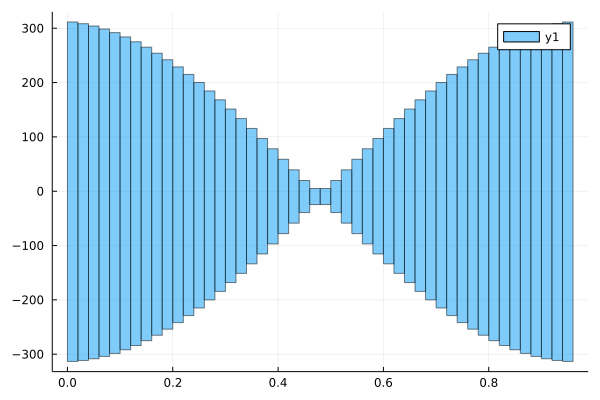

In [74]:
boxes_2der2 = IntervalBox.(x[1:n-2], u_2der2)
plot(boxes_2der2)

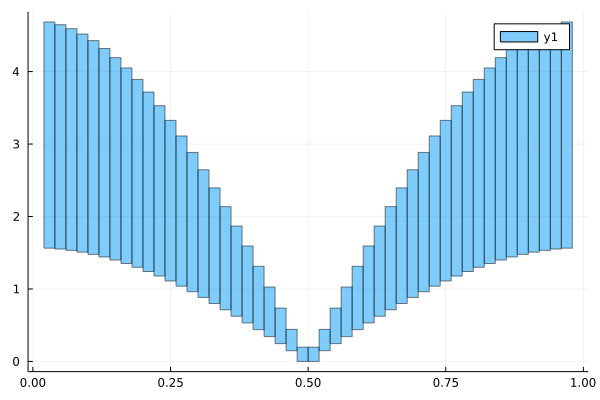

In [80]:
plot(IntervalBox.(x[2:n-1],.√(u_der.^2)))